### author by yangshichen
### 注意：脚本仅供参考，使用前请仔细阅读

### 调用GPU

In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import seaborn as sb
from matplotlib.pyplot import rc_context
import matplotlib.pyplot as plt
import rapids_singlecell as rsc
from scipy.io import mmread
from scipy.sparse import csr_matrix
import cupy as cp
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42
import scrublet as scr

import warnings
warnings.filterwarnings("ignore")

In [2]:
import rmm
rmm.reinitialize(managed_memory=True)
#cp.cuda.set_allocator(rmm.rmm_cupy_allocator)

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, frameon=False)
sc._settings.ScanpyConfig.n_jobs=70

scanpy==1.9.6 anndata==0.10.3 umap==0.5.5 numpy==1.24.4 scipy==1.11.4 pandas==1.5.3 scikit-learn==1.3.2 statsmodels==0.14.0 igraph==0.10.8 pynndescent==0.5.11


In [4]:
cluster_cols = ["#DC050C", "#FB8072", "#1965B0", "#7BAFDE", "#882E72", 
                "#B17BA6", "#FF7F00", "#FDB462", "#E7298A", "#E78AC3", 
                "#33A02C", "#B2DF8A", "#55A1B1", "#8DD3C7", "#A6761D", 
                "#E6AB02", "#7570B3", "#BEAED4", "#666666", "#999999", 
                "#aa8282", "#d4b7b7", "#8600bf", "#ba5ce3", "#808000", 
                "#aeae5c", "#1e90ff", "#00bfff", "#56ff0d", "#ffff00"]

### 聚类分群1

In [5]:
adata = sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/Myeloid_raw.h5ad")
adata.X = adata.layers['counts'].copy()
adata

AnnData object with n_obs × n_vars = 370555 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std'
    uns: 'age_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r2.0_n2_colors', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'sample_colors', 'stage_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivitie

In [6]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata,batch_key="stage")
adata.var.highly_variable.value_counts()

normalizing counts per cell
    finished (0:00:40)
extracting highly variable genes
    finished (0:00:19)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


False    19493
True      2186
Name: highly_variable, dtype: int64

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:01:21)


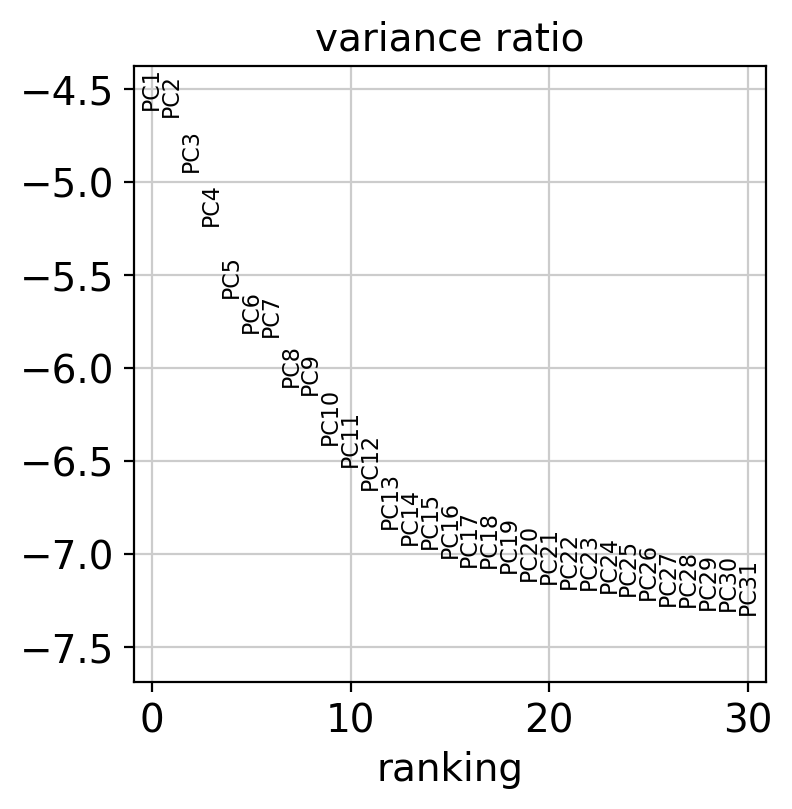

In [7]:
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata, svd_solver='arpack',n_comps=50,use_highly_variable=True)
sc.pl.pca_variance_ratio(adata,n_pcs=30,log=True)

In [8]:
rsc.pp.harmony_integrate(adata,key='experiments',max_iter_harmony = 30)

2024-05-10 14:47:31,699 - harmonypy_gpu - INFO - Iteration 1 of 30
2024-05-10 14:47:58,582 - harmonypy_gpu - INFO - Iteration 2 of 30
2024-05-10 14:48:25,458 - harmonypy_gpu - INFO - Iteration 3 of 30
2024-05-10 14:48:52,954 - harmonypy_gpu - INFO - Converged after 3 iterations


In [9]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=23, use_rep='X_pca_harmony')
sc.tl.umap(adata,min_dist = 0.5)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:54)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:10:27)


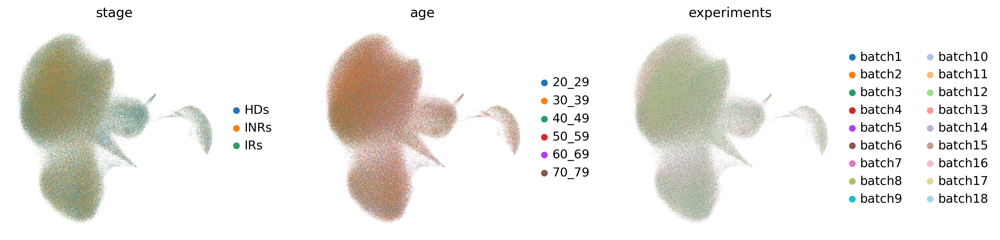

In [10]:
sc.pl.umap(adata, color=['stage', 'age', 'experiments'], wspace=0.3)

running Leiden clustering
    finished: found 60 clusters and added
    'leiden_r5.0_n2', the cluster labels (adata.obs, categorical) (0:02:09)


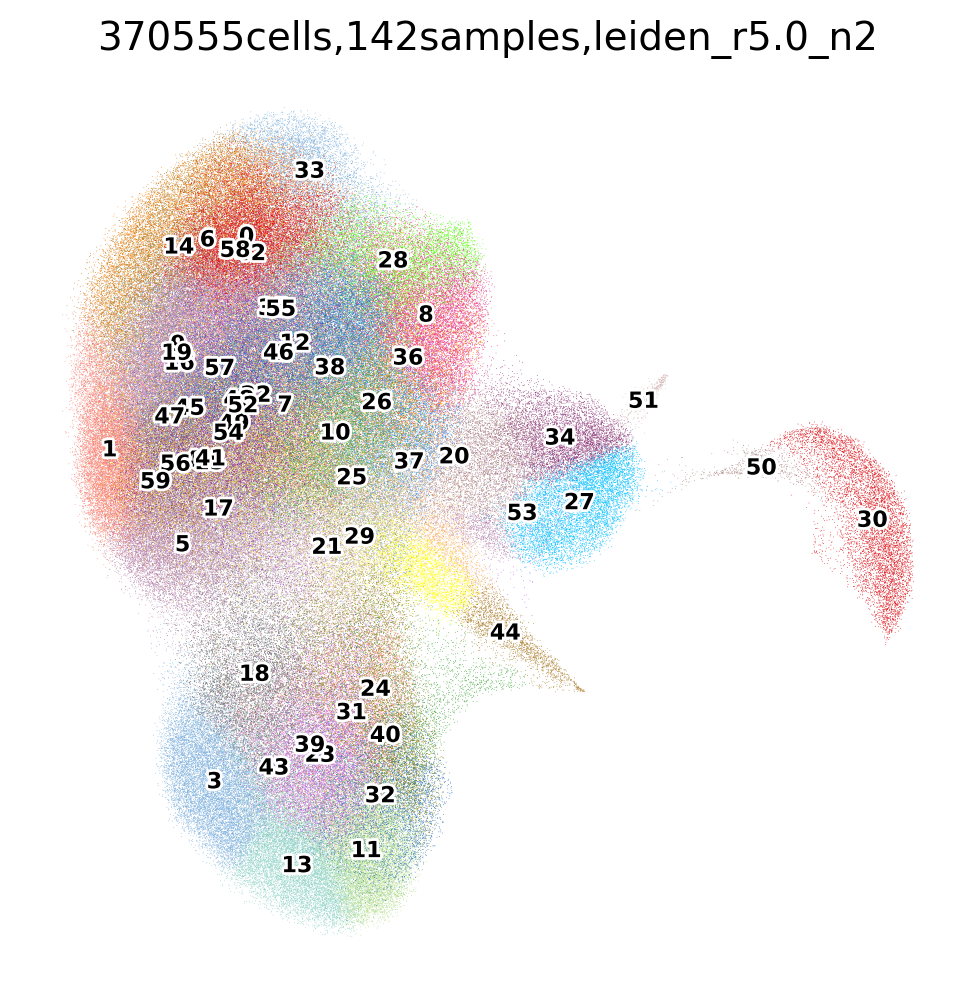

In [13]:
sc.tl.leiden(adata,resolution=5.0,n_iterations=2,key_added='leiden_r5.0_n2')
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata,color=['leiden_r5.0_n2'],legend_fontsize=8,legend_fontoutline=2,
               palette=cluster_cols,legend_loc="on data",title='370555cells,142samples,leiden_r5.0_n2')

### 去除双胞群

In [18]:
subdata = adata[~adata.obs['leiden_r5.0_n2'].isin(['29','37','40',"44","53",'59'])]
subdata

View of AnnData object with n_obs × n_vars = 353468 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std', 'dispersions', 'dispersions_norm', 'highly_variable_intersection'
    uns: 'age_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r2.0_n2_colors', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'sample_colors', 'stage_colors', 'umap', 'leiden_r5.0

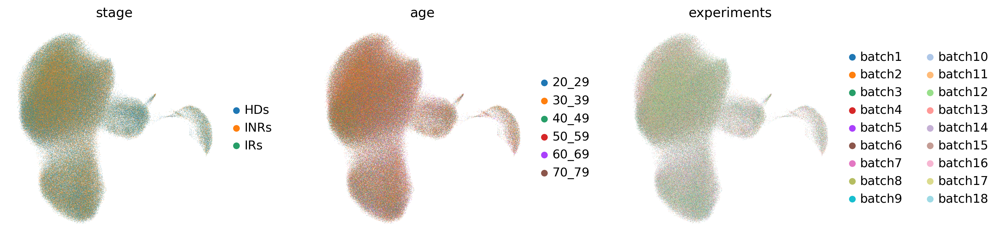

In [19]:
sc.pl.umap(subdata, color=['stage', 'age', 'experiments'], wspace=0.3)

In [20]:
subdata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/Myeloid_filter.h5ad')

### 聚类分群2

In [5]:
adata = sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/Myeloid_filter.h5ad")
adata.X = adata.layers['counts'].copy()
adata

AnnData object with n_obs × n_vars = 353468 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std', 'dispersions', 'dispersions_norm', 'highly_variable_intersection'
    uns: 'age_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r2.0_n2_colors', 'leiden_r5.0_n2_colors', 'log1p', 'neighbors', 'pca', 'phase_ordered_colors', 'sample_colors', 'stage_colors', 'um

In [6]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata,batch_key="stage")
adata.var.highly_variable.value_counts()

normalizing counts per cell
    finished (0:00:38)
extracting highly variable genes
    finished (0:00:18)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


False    19507
True      2172
Name: highly_variable, dtype: int64

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:01:15)


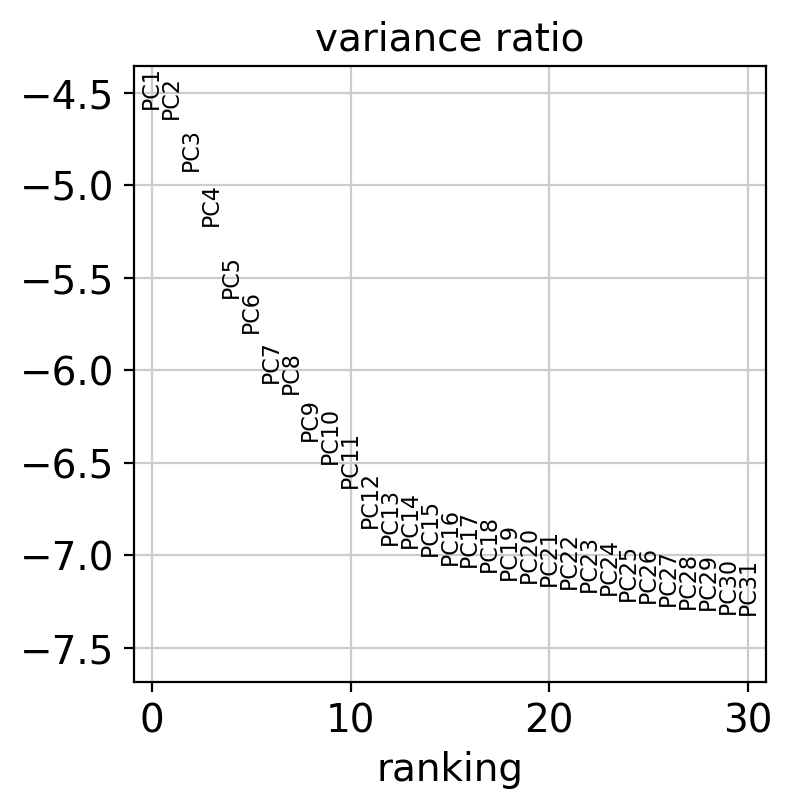

In [7]:
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata, svd_solver='arpack',n_comps=50,use_highly_variable=True)
sc.pl.pca_variance_ratio(adata,n_pcs=30,log=True)

In [8]:
rsc.pp.harmony_integrate(adata,key='experiments',max_iter_harmony = 30)

2024-05-10 15:17:18,278 - harmonypy_gpu - INFO - Iteration 1 of 30
2024-05-10 15:17:44,074 - harmonypy_gpu - INFO - Iteration 2 of 30
2024-05-10 15:18:09,800 - harmonypy_gpu - INFO - Iteration 3 of 30
2024-05-10 15:18:36,323 - harmonypy_gpu - INFO - Converged after 3 iterations


In [15]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=23, use_rep='X_pca_harmony')
sc.tl.umap(adata,min_dist = 0.5)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:26)
computing UMAP


IOStream.flush timed out
IOStream.flush timed out


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:08:58)


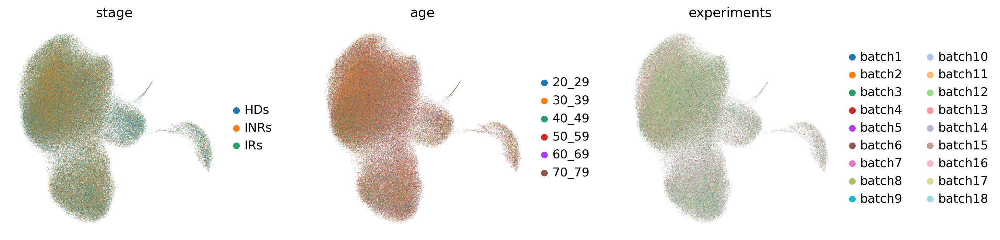

In [16]:
sc.pl.umap(adata, color=["stage",'age',"experiments"],wspace=0.3)

### pDC亚聚类

In [20]:
adata_sub = adata[adata.obs['leiden_r2.0_n2'].isin(['18'])]
adata_hvg = adata_sub[:,adata_sub.var["highly_variable"]==True]
adata_hvg

View of AnnData object with n_obs × n_vars = 7348 × 2172
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2', 'leiden_r1.5_n2', 'leiden_r1.8_n2', 'leiden_r2.2_n2'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std', 'dispersions', 'dispersions_norm', 'highly_variable_intersection'
    uns: 'age_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r2.0_n2_colors', 'leiden_r5.0_n2_colors', 'log1p', 'neighbors', 'pca', '

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


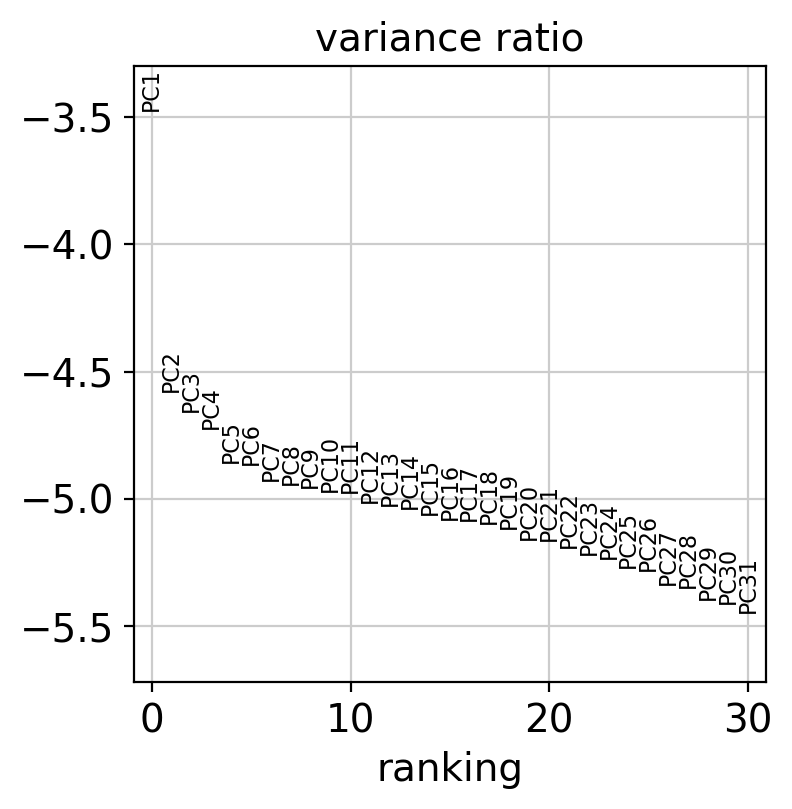

In [21]:
sc.tl.pca(adata_hvg, svd_solver='arpack',n_comps=50)
sc.pl.pca_variance_ratio(adata_hvg,n_pcs=30,log=True)

In [22]:
adata_sub.uns['pca'] = adata_hvg.uns['pca'].copy()
adata_sub.obsm['X_pca'] = adata_hvg.obsm['X_pca'].copy()

In [23]:
rsc.pp.harmony_integrate(adata_sub,key='experiments',max_iter_harmony = 30)

2024-05-10 15:54:25,519 - harmonypy_gpu - INFO - Iteration 1 of 30
2024-05-10 15:54:27,471 - harmonypy_gpu - INFO - Iteration 2 of 30
2024-05-10 15:54:29,141 - harmonypy_gpu - INFO - Iteration 3 of 30
2024-05-10 15:54:30,168 - harmonypy_gpu - INFO - Iteration 4 of 30
2024-05-10 15:54:32,074 - harmonypy_gpu - INFO - Iteration 5 of 30
2024-05-10 15:54:32,869 - harmonypy_gpu - INFO - Iteration 6 of 30
2024-05-10 15:54:33,663 - harmonypy_gpu - INFO - Iteration 7 of 30
2024-05-10 15:54:34,453 - harmonypy_gpu - INFO - Iteration 8 of 30
2024-05-10 15:54:35,162 - harmonypy_gpu - INFO - Iteration 9 of 30
2024-05-10 15:54:35,872 - harmonypy_gpu - INFO - Iteration 10 of 30
2024-05-10 15:54:36,595 - harmonypy_gpu - INFO - Iteration 11 of 30
2024-05-10 15:54:37,311 - harmonypy_gpu - INFO - Iteration 12 of 30
2024-05-10 15:54:38,028 - harmonypy_gpu - INFO - Iteration 13 of 30
2024-05-10 15:54:38,744 - harmonypy_gpu - INFO - Iteration 14 of 30
2024-05-10 15:54:39,464 - harmonypy_gpu - INFO - Iteratio

In [24]:
sc.pp.neighbors(adata_sub, n_neighbors=30, n_pcs=11, use_rep='X_pca_harmony')
sc.tl.umap(adata_sub,min_dist = 0.3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


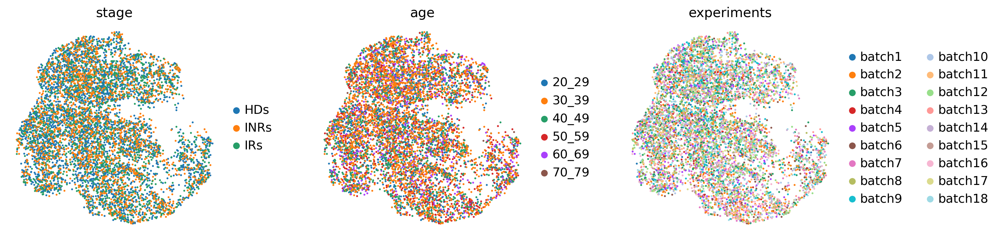

In [25]:
sc.pl.umap(adata_sub, color=['stage', 'age', 'experiments'], wspace=0.3)

running Leiden clustering
    finished: found 7 clusters and added
    'leiden_r0.5_n2', the cluster labels (adata.obs, categorical) (0:00:00)


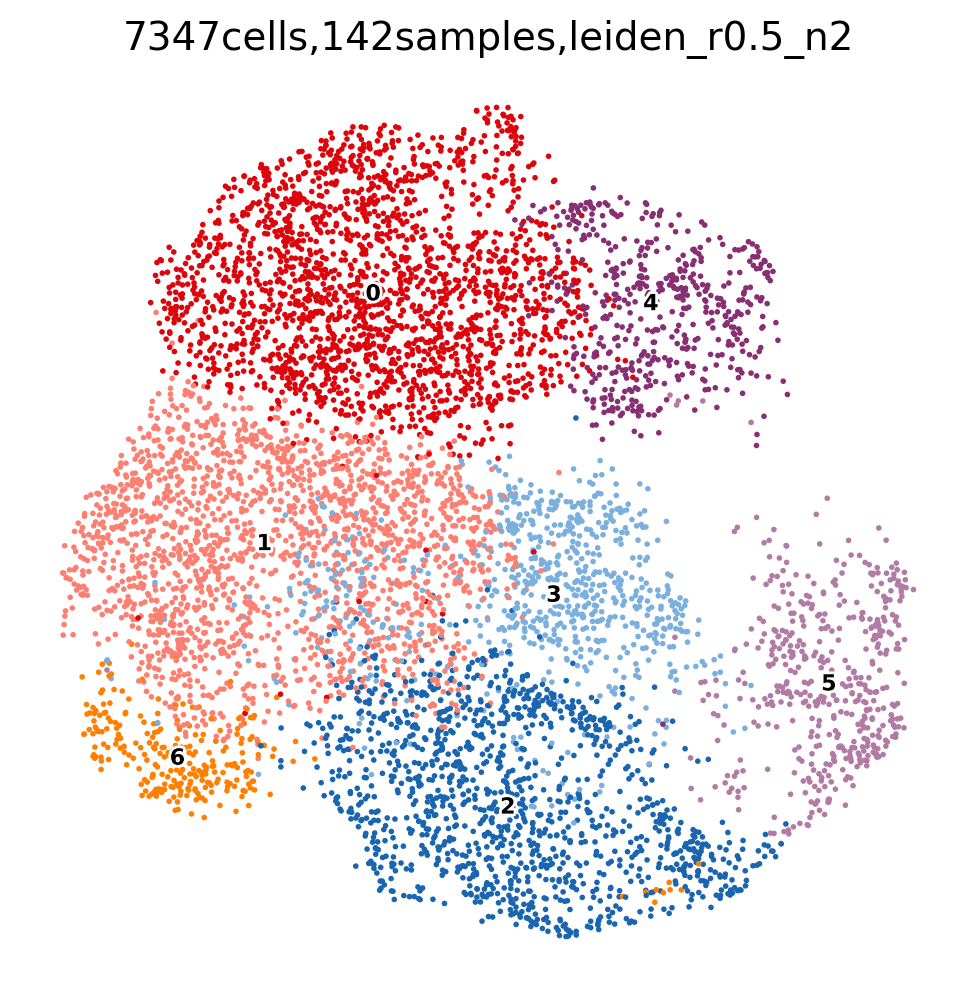

In [26]:
sc.tl.leiden(adata_sub,resolution=0.5,n_iterations=2,key_added='leiden_r0.5_n2')
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata_sub,color=['leiden_r0.5_n2'],legend_fontsize=8,legend_fontoutline=2,
               palette=cluster_cols,legend_loc="on data",title='7347cells,142samples,leiden_r0.5_n2')

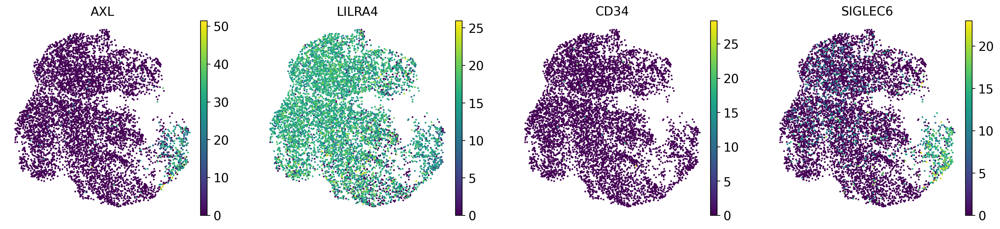

In [27]:
sc.pl.umap(adata_sub, color=["AXL","LILRA4","CD34","SIGLEC6"])

In [28]:
new_cluster_names = ['pDC_LILRA4','pDC_LILRA4','pDC_LILRA4','pDC_LILRA4',
                     'pDC_LILRA4','pDC_AXL','pDC_LILRA4']
adata_sub.obs['leiden_r0.5_n2']=adata_sub.obs['leiden_r0.5_n2'].replace(
    to_replace = list(adata_sub.obs['leiden_r0.5_n2'].cat.categories.values),value = new_cluster_names)

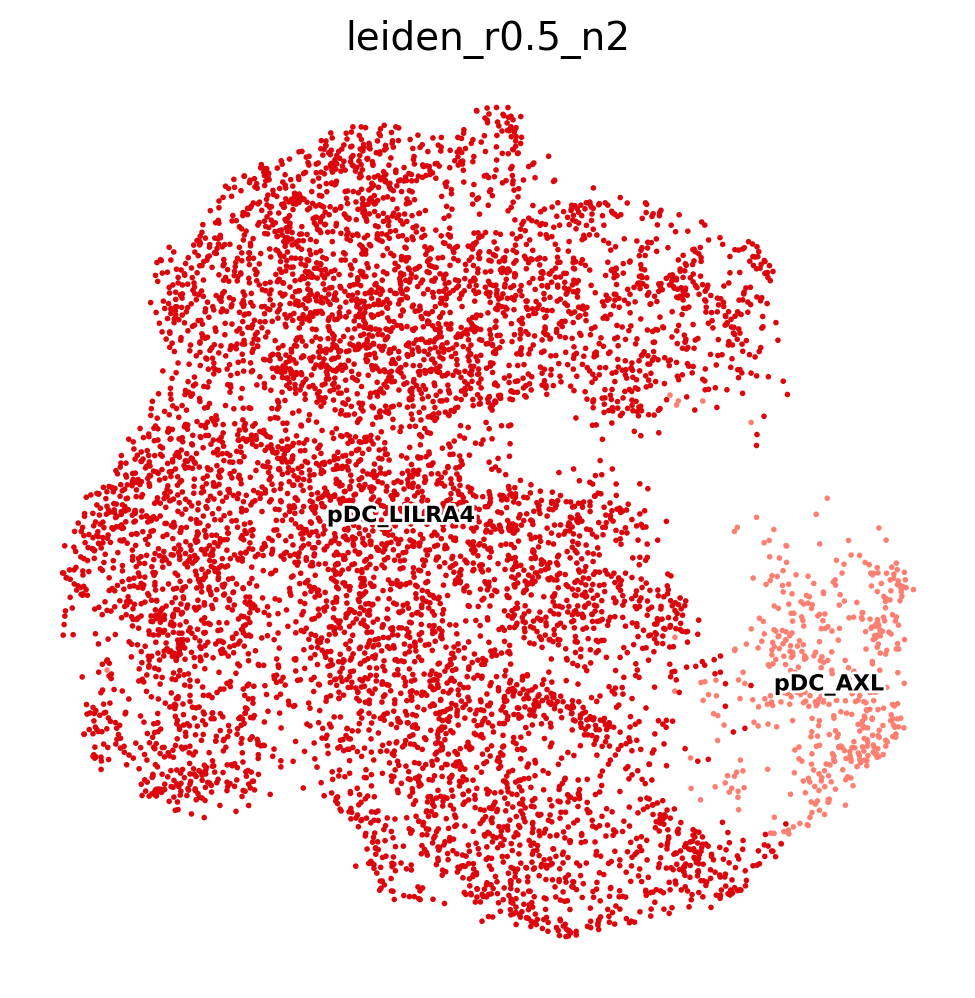

In [29]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata_sub, color=['leiden_r0.5_n2'], legend_loc='on data',
               legend_fontsize=8, legend_fontoutline=2,palette=cluster_cols)

In [30]:
adata.obs['celltype_r2.0'] = adata.obs['leiden_r2.0_n2']

In [31]:
adata.obs['celltype_r2.0'] = adata.obs.index.map(adata_sub.obs['leiden_r0.5_n2'].to_dict())

In [32]:
adata.obs['celltype_r2.0'].fillna(adata.obs['leiden_r2.0_n2'],inplace=True)

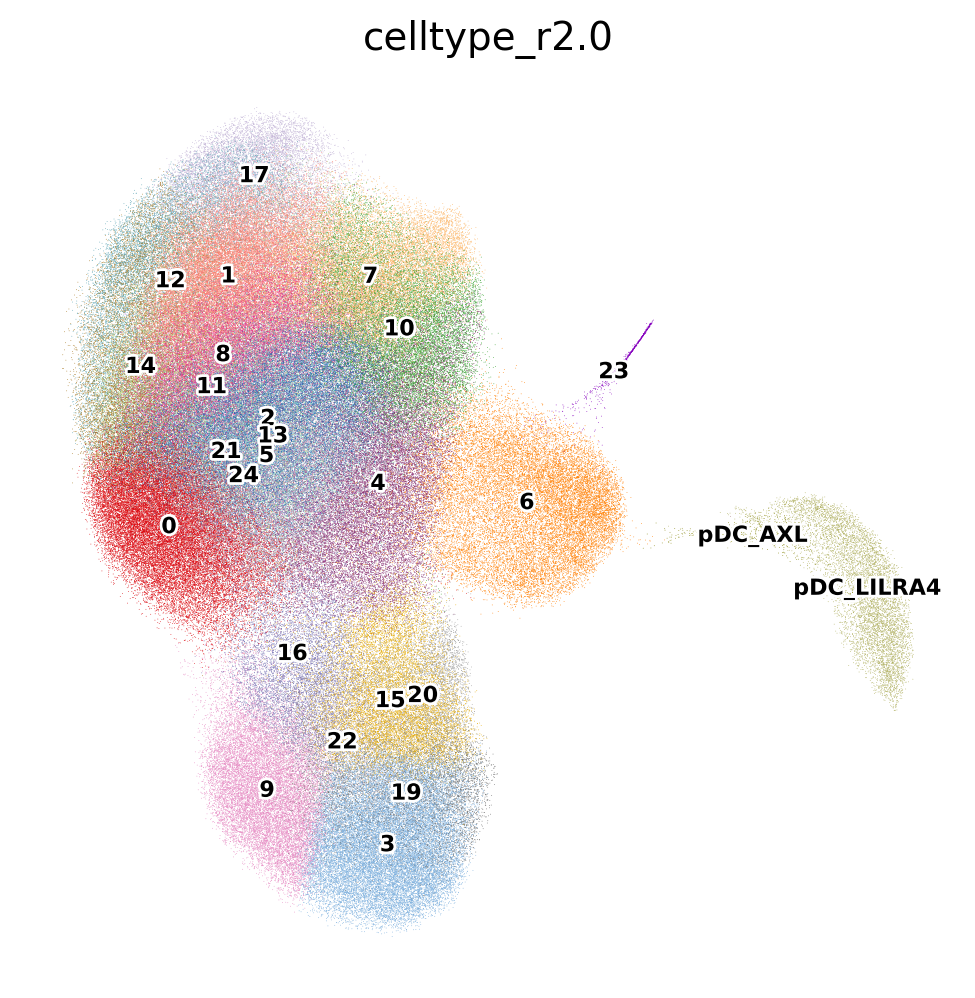

In [34]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata, color=['celltype_r2.0'],legend_loc="on data",
               legend_fontsize=8, legend_fontoutline=2,palette=cluster_cols)

In [35]:
adata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/Myeloid_filter.h5ad')

### COSG

In [36]:
adata=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/Myeloid_filter.h5ad")
adata

AnnData object with n_obs × n_vars = 353468 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'leiden_r5.0_n2', 'leiden_r1.5_n2', 'leiden_r1.8_n2', 'leiden_r2.2_n2', 'celltype_r2.0'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std', 'dispersions', 'dispersions_norm', 'highly_variable_intersection'
    uns: 'age_colors', 'celltype_r2.0_colors', 'experiments_colors', 'hvg', 'leiden', 'leiden_r1.5_n2_colors', 'leiden_r1.8_n2_col

In [37]:
import cosg as cosg
import importlib
importlib.reload(cosg)

<module 'cosg' from '/home/yangshichen/mambaforge/envs/rsc/lib/python3.10/site-packages/cosg/__init__.py'>

In [38]:
cosg.cosg(adata,
    key_added='cosg',
    mu=1,
    n_genes_user=50,
    groupby='celltype_r2.0')

**finished identifying marker genes by COSG**


In [39]:
colnames = ['names', 'scores']
test = [pd.DataFrame(adata.uns["cosg"][c]) for c in colnames]
test = pd.concat(test, axis=1, names=[None, 'group'], keys=colnames)

markers = {}
cats = adata.obs['celltype_r2.0'].cat.categories
for i, c in enumerate(cats):
    cell_type_df = test.loc[:, 'names'][str(c)]
    scores_df = test.loc[:, 'scores'][str(c)]
    markers[str(c)] = cell_type_df.values.tolist()[:10]

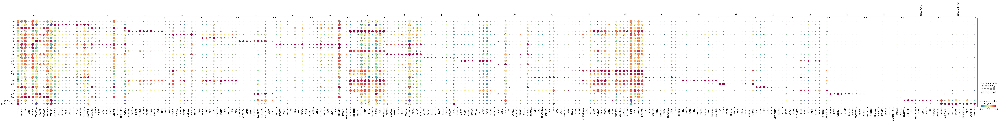

In [40]:
sc.pl.dotplot(adata, 
              var_names = markers, 
              groupby='celltype_r2.0',
              cmap='Spectral_r',
              standard_scale='var',save='_celltype_r2.0.pdf') 

In [41]:
marker_gene=pd.DataFrame(adata.uns['cosg']['names'])
marker_gene.head()

,0,1,10,11,12,13,14,15,16,17,...,24,3,4,5,6,7,8,9,pDC_AXL,pDC_LILRA4
0,TPT1,TGOLN2,AKAP9,IGHG3,KLRD1,LMNA,TCF7,FFAR2,LFNG,TCF7,...,OR10V1,SIGLEC10,ATF5,IFI44L,FCER1A,CYP1B1,AQP9,FCGR3A,ADAM33,LILRA4
1,S100A8,FMNL1,GOLGB1,IGHG4,GZMH,EMP1,IL7R,MGLL,MGLL,CD6,...,ARNTL2,VMO1,LIPA,IFIT3,CLEC10A,MEGF9,VNN2,CDKN1C,SIGLEC6,SERPINF1
2,LYZ,NFKBID,ZFHX3,IGLC1,MYOM2,CRIP1,TRABD2A,NSMF,ADGRE5,BCL11B,...,RNF113B,LYPD2,MARCKS,MX1,CD1C,PADI4,SLC2A3,MS4A7,AXL,UGCG
3,CD14,YIPF4,NIPBL,IGHG1,SPON2,ID1,BCL11B,APOBEC3A,ZBTB7A,NMT2,...,Z84484.1,SMIM25,MARCO,XAF1,ENHO,RFLNB,CYP1B1,NAP1L1,PPP1R14A,SMPD3
4,S100A9,MAU2,GAS7,PAX5,PKHD1,CYP2S1,TRAC,ACP2,LILRB1,RNF157,...,NMNAT3,PILRA,LAP3,SIGLEC1,NDRG2,F5,IRS2,LST1,PLS3,ITM2C


In [42]:
marker_gene.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/Subcelltype/Myeloid/figures/_celltype_r2.0_marker_gene.csv')

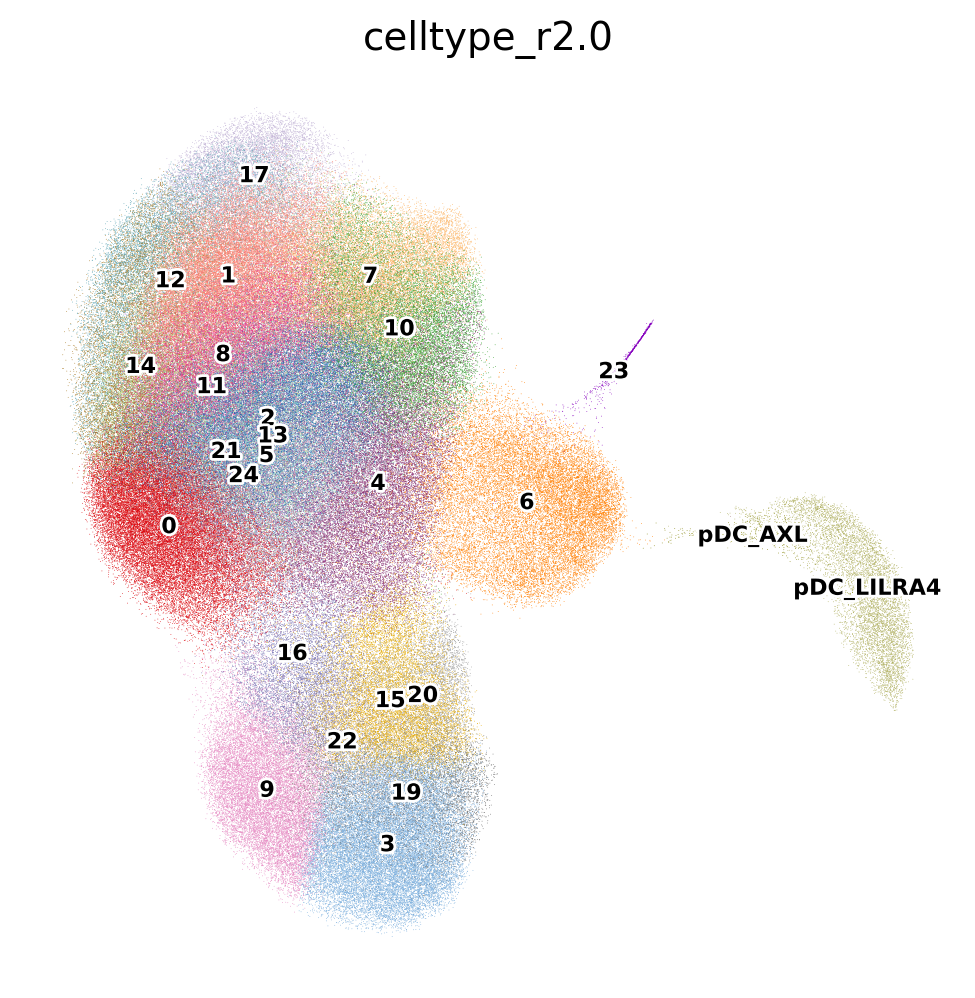

In [45]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata, color=['celltype_r2.0'],legend_loc="on data",
               legend_fontsize=8, legend_fontoutline=2,palette=cluster_cols)

In [8]:
colnames = ['names', 'scores']
test = [pd.DataFrame(adata.uns["cosg"][c]) for c in colnames]
test = pd.concat(test, axis=1, names=[None, 'group'], keys=colnames)

markers = {}
cats = adata.obs['leiden_r1.8_n2'].cat.categories
for i, c in enumerate(cats):
    cell_type_df = test.loc[:, 'names'][str(c)]
    scores_df = test.loc[:, 'scores'][str(c)]
    markers[str(c)] = cell_type_df.values.tolist()[:10]

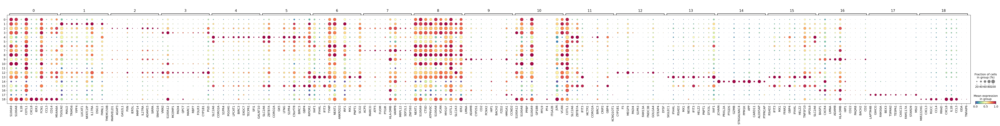

In [9]:
sc.pl.dotplot(adata, 
              var_names = markers, 
              groupby='leiden_r1.8_n2',
              cmap='Spectral_r',
              standard_scale='var',save='_filter_dotplot_leiden_r1.8_n2.pdf') 

In [10]:
marker_gene=pd.DataFrame(adata.uns['cosg']['names'])
marker_gene.head()

,0,1,10,11,12,13,14,15,16,17,18,2,3,4,5,6,7,8,9
0,S100A9,TGOLN2,S100A12,COTL1,CYP1B1,SIGLEC1,JCHAIN,RSAD2,BASP1,LAPTM4B,MIR222HG,MARVELD1,VNN2,SLC2A6,SLC2A6,XAF1,ACP5,NEAT1,LMNA
1,S100A8,MAU2,S100A8,SLC2A6,F5,IFI44L,PRXL2A,IFIT3,CXCR4,GIHCG,CXCL3,AGAP3,S100A12,CORO2A,ZBTB7A,IFI44L,MARCO,S100A9,ADAM8
2,IL1B,TRIM56,PPBP,ZBTB7A,MEGF9,RSAD2,PTGDS,MX1,LMNA,FAM30A,RGCC,GAS2L1,MCEMP1,S1PR4,CORO2A,IFIT3,ATF5,CTSD,CYP2S1
3,COTL1,YIPF4,S100A9,IFIT3,PADI4,MX1,GZMB,FFAR2,ADAM8,BEX3,CCL4,PXN,PADI4,PGGHG,GK5,TYMP,FUOM,ATP6V0C,CD2
4,CXCL8,LUCAT1,GP1BB,MCTP2,S1PR3,NEXN,ST6GALNAC4,GBP4,HLA-DMB,TSPAN2,RRAD,IER5L,QPCT,LPCAT1,LFNG,NEAT1,PTGIR,S100A8,PCNX2


In [11]:
marker_gene.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/Subcelltype/Myeloid/all_leiden_r1.8_n2_marker_gene.csv')

### 注释

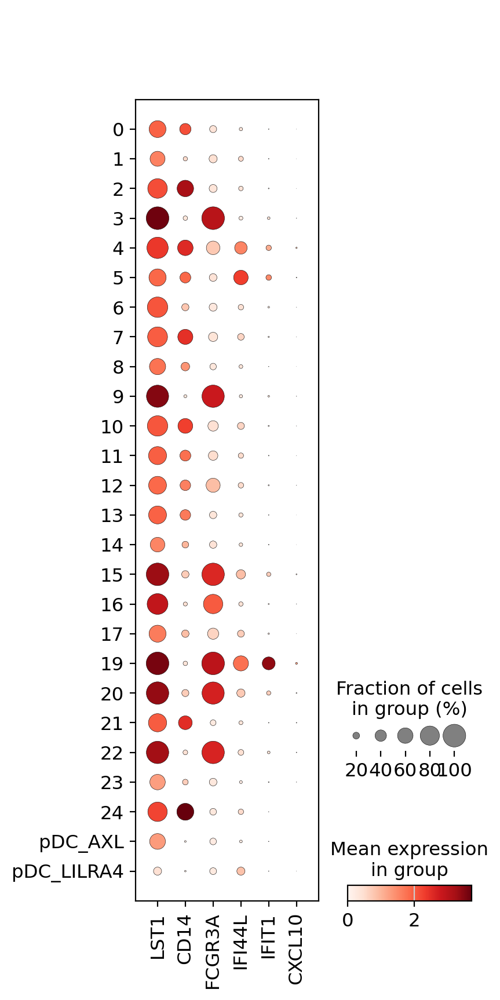

In [69]:
sc.pl.dotplot(adata, ["LST1","CD14","FCGR3A","IFI44L","IFIT1","CXCL10"], groupby='celltype_r2.0')

In [72]:
adata.obs = adata.obs.drop(['leiden_r5.0_n2', 'leiden_r1.5_n2', 'leiden_r1.8_n2', 'leiden_r2.2_n2'],axis=1)

In [73]:
new_cluster_names = ['cMono-CD14','cMono-CD14','cMono-CD14','ncMono-FCGR3A','cMono-IFI44L','cMono-IFI44L',
                     'cDC2-CD1C','cMono-CD14','cMono-CD14','ncMono-FCGR3A','cMono-CD14','cMono-CD14',
                     'cMono-CD14','cMono-CD14','cMono-CD14','ncMono-IFI44L','ncMono-FCGR3A','cMono-CD14',
                     'ncMono-IFIT1','ncMono-C1QA','cMono-IL1B','ncMono-FCGR3A','cDC1-BATF3','cMono-CD14',
                     'pDC_AXL','pDC_LILRA4']
adata.obs['celltype_L3']=adata.obs['celltype_r2.0'].replace(to_replace = list(adata.obs['celltype_r2.0'].cat.categories.values),
                                                         value = new_cluster_names)

In [5]:
adata=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/Myeloid_celltype.h5ad")
adata

AnnData object with n_obs × n_vars = 353468 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'celltype_r2.0', 'celltype_L3'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std', 'dispersions', 'dispersions_norm', 'highly_variable_intersection'
    uns: 'age_colors', 'celltype_r2.0_colors', 'cosg', 'experiments_colors', 'hvg', 'leiden', 'leiden_r1.5_n2_colors', 'leiden_r1.8_n2_colors', 'leiden_r2.0_n2_colors', 'leiden_r2.2_n2_co

In [7]:
adata.obs['celltype_L3'] = adata.obs['celltype_L3'].replace({'pDC_LILRA4': 'pDC-LILRA4'})
adata.obs['celltype_L3'] = adata.obs['celltype_L3'].replace({'pDC_AXL': 'pDC-AXL'})

In [8]:
adata.obs['celltype_L3'].value_counts()

cMono-CD14       197004
ncMono-FCGR3A     54631
cMono-IFI44L      44770
cDC2-CD1C         21242
ncMono-IFI44L     12523
pDC-LILRA4         6870
ncMono-IFIT1       6324
ncMono-C1QA        5267
cMono-IL1B         3491
cDC1-BATF3          868
pDC-AXL             478
Name: celltype_L3, dtype: int64

In [75]:
phases = ['cMono-CD14','cMono-IFI44L','cMono-IL1B','ncMono-FCGR3A','ncMono-IFI44L',
          'ncMono-IFIT1','ncMono-C1QA','cDC1-BATF3','cDC2-CD1C','pDC-LILRA4','pDC-AXL']
adata.obs["phase_ordered"] = pd.Categorical(values=adata.obs.celltype_L3, categories=phases, ordered=True)

In [7]:
Myeloid_colors={'cMono-CD14':'#779649',
          'cMono-IFI44L':'#C0D09D',
          'cMono-IL1B':'#13393E',
          'ncMono-FCGR3A':'#AC9F8A',
          'ncMono-IFI44L':'#D5C8A0',
          'ncMono-IFIT1':'#68361A',
          'ncMono-C1QA':'#79836C',
          'cDC1-BATF3':'#BFC1A9',
          'cDC2-CD1C':'#9BB496',
          'pDC-LILRA4':'#E0E0D0',
          'pDC-AXL':'#8F6D5F'
}

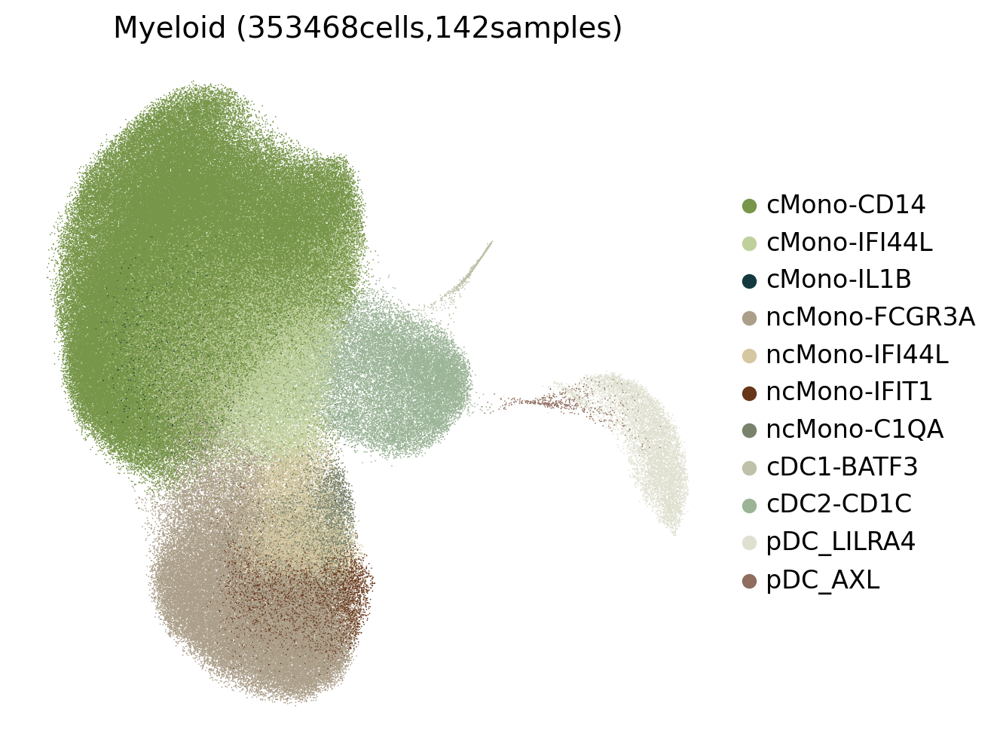

In [8]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(adata,color=['phase_ordered'],legend_fontsize=12,size=1.5,legend_fontoutline=2,
               palette=Myeloid_colors,title='Myeloid (353468cells,142samples)',#legend_loc="on data",
               save='_Myeloid_celltype_L3.pdf')

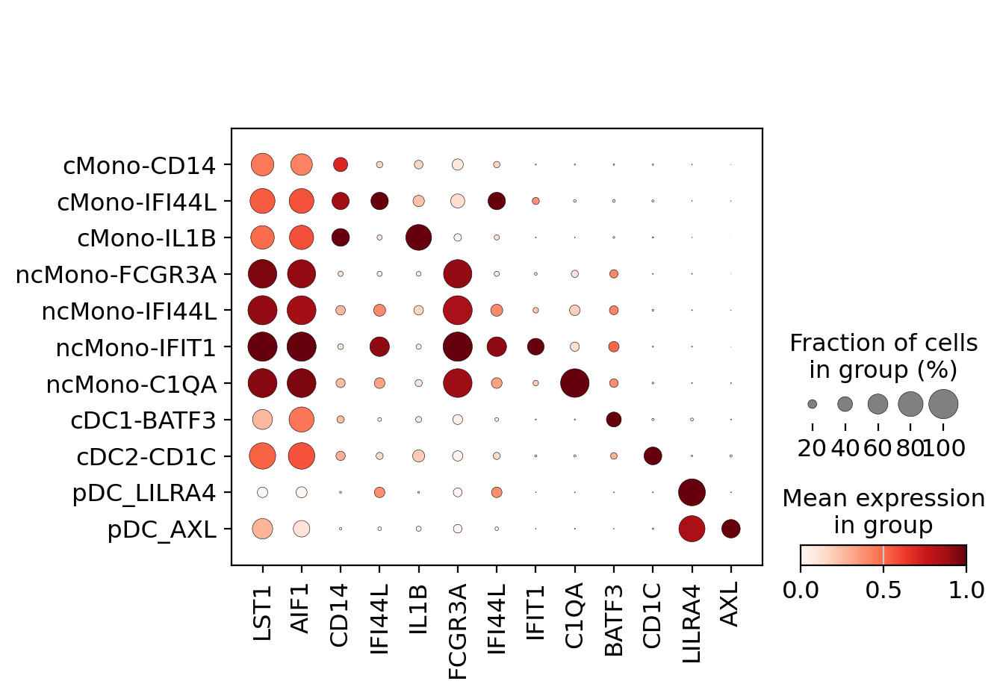

In [91]:
sc.pl.dotplot(adata, ["LST1","AIF1","CD14","IFI44L","IL1B",'FCGR3A','IFI44L',
                      "IFIT1","C1QA","BATF3","CD1C","LILRA4","AXL"], 
              categories_order=['cMono-CD14','cMono-IFI44L','cMono-IL1B','ncMono-FCGR3A','ncMono-IFI44L',
                                'ncMono-IFIT1','ncMono-C1QA','cDC1-BATF3','cDC2-CD1C','pDC_LILRA4','pDC_AXL'],
              standard_scale='var',
              groupby='celltype_L3',save='celltype_L3.pdf')

In [9]:
adata.write('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/Myeloid_celltype.h5ad')

### 细胞比例

In [10]:
# 计算每个样本中每种细胞类型的计数
cell_counts = adata.obs.groupby(['sample', 'celltype_L3']).size().reset_index(name='count')
# 计算每个样本中细胞类型的总计数
sample_totals = cell_counts.groupby('sample')['count'].sum().reset_index(name='total_count')
# 合并计数和总计数数据框
merged_data = pd.merge(cell_counts, sample_totals, on='sample')
# 计算每个样本中细胞类型的比例
merged_data['proportion'] = merged_data['count'] / merged_data['total_count']
# 输出结果
print(merged_data)
merged_data.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/Subcelltype/Myeloid/proportions_L3.csv', index=False)

       sample    celltype_L3  count  total_count  proportion
0     HD-H134     cMono-CD14   2909         5293    0.549594
1     HD-H134  ncMono-FCGR3A   1210         5293    0.228604
2     HD-H134   cMono-IFI44L    421         5293    0.079539
3     HD-H134      cDC2-CD1C    450         5293    0.085018
4     HD-H134  ncMono-IFI44L     59         5293    0.011147
...       ...            ...    ...          ...         ...
1557  PD-H308    ncMono-C1QA     51         1161    0.043928
1558  PD-H308     cMono-IL1B      1         1161    0.000861
1559  PD-H308     cDC1-BATF3      0         1161    0.000000
1560  PD-H308        pDC-AXL      1         1161    0.000861
1561  PD-H308     pDC-LILRA4     71         1161    0.061154

[1562 rows x 5 columns]


### DEG

In [103]:
adata=sc.read("/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/HIV-pbmc2/Myeloid_celltype.h5ad")
adata

AnnData object with n_obs × n_vars = 353468 × 21679
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'doublet_score', 'doublet', 'batch', 'sample', 'stage', 'experiments', 'age', 'total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'pct_counts_hb', 'total_counts_ncRNA', 'pct_counts_ncRNA', 'total_counts_LOC', 'pct_counts_LOC', 'total_counts_erccs', 'pct_counts_erccs', 'leiden_r2.0_n2', 'celltype_L1', 'phase_ordered', 'celltype_r2.0', 'celltype_L3'
    var: 'hb', 'rp', 'ncRNA', 'LOC', 'erccs', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'mean', 'std', 'dispersions', 'dispersions_norm', 'highly_variable_intersection'
    uns: 'age_colors', 'celltype_r2.0_colors', 'cosg', 'experiments_colors', 'hvg', 'leiden', 'leiden_r1.5_n2_colors', 'leiden_r1.8_n2_colors', 'leiden_r2.0_n2_colors', 'leiden_r2.2_n2_co

In [105]:
unique_celltypes = adata.obs['celltype_L3'].unique()
unique_celltypes

['cMono-CD14', 'ncMono-FCGR3A', 'ncMono-C1QA', 'cDC2-CD1C', 'cMono-IFI44L', ..., 'pDC_AXL', 'ncMono-IFI44L', 'pDC_LILRA4', 'cDC1-BATF3', 'cMono-IL1B']
Length: 11
Categories (11, object): ['cMono-CD14', 'ncMono-FCGR3A', 'cMono-IFI44L', 'cDC2-CD1C', ..., 'cMono-IL1B', 'cDC1-BATF3', 'pDC_AXL', 'pDC_LILRA4']

In [106]:
for celltype in unique_celltypes:
    celltype_data = adata[adata.obs['celltype_L3'] == celltype, :]
    celltype_data.uns['log1p']['base']=None
    sc.tl.rank_genes_groups(celltype_data, groupby='stage',groups=['IRs','INRs'],reference='HDs',method='wilcoxon', key_added = "wilcoxon_HDs")
    sc.tl.rank_genes_groups(celltype_data, groupby='stage',groups=['INRs'],reference='IRs',method='wilcoxon', key_added = "wilcoxon_IRs")
    genes1 = sc.get.rank_genes_groups_df(celltype_data, group='IRs', key='wilcoxon_HDs')
    genes2 = sc.get.rank_genes_groups_df(celltype_data, group='INRs', key='wilcoxon_HDs')
    genes3 = sc.get.rank_genes_groups_df(celltype_data, group='INRs', key='wilcoxon_IRs')
    genes1.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/Subcelltype/Myeloid/DEG/{}_IRs_vs_HDs.csv'.format(celltype), index=False)
    genes2.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/Subcelltype/Myeloid/DEG/{}_INRs_vs_HDs.csv'.format(celltype), index=False)
    genes3.to_csv('/media/AnalysisDisk1/Yanshichen/0_HIV_RNA/Subcelltype/Myeloid/DEG/{}_INRs_vs_IRs.csv'.format(celltype), index=False)

ranking genes
    finished: added to `.uns['wilcoxon_HDs']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:17:38)
ranking genes
    finished: added to `.uns['wilcoxon_IRs']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:07:15)
ranking genes
    finished: added to `.uns['wilcoxon_HDs']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group